In [1]:
# Put these at the top of every notebook, to get automatic reloading and inline plotting
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
# This file contains all the main external libs we'll use
import fastai
from fastai.imports import *
from fastai.transforms import *
from fastai.conv_learner import *
from fastai.model import *
from fastai.dataset import *
from fastai.sgdr import *
from fastai.plots import *

import torch.nn as nn 
import torch 
import numpy 
%matplotlib inline

from torch.autograd import Variable
from torchvision import models
from fastai import conv_learner
import numpy as np
import matplotlib.pyplot as plt
import skimage.transform

In [7]:
PATH = "/scratch/as3ek/chrc_data_case_preserved_1000_normal_balanced/"
sz=256
arch=resnet50

In [8]:
torch.cuda.is_available()

True

In [9]:
torch.backends.cudnn.enabled

True

In [10]:
os.listdir(PATH)

['models', 'tmp', 'valid', 'train']

In [11]:
files = os.listdir(f'{PATH}valid/Celiac')[:5]
files

['C12-64_01a___6000_4000___0_250_0.jpg',
 'C16-77_02___4000_0___0_0_0.jpg',
 'C10-47_02___16000_18040___500_0_0.jpg',
 'C16-77_01___4000_2000___500_0_0.jpg',
 'C11-54_05___3000_2000___500_250_0.jpg']

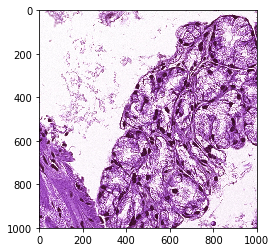

In [12]:
img = plt.imread(f'{PATH}valid/Celiac/{files[4]}')
plt.imshow(img);

In [13]:
arch=resnet50
data = ImageClassifierData.from_paths(PATH, tfms=tfms_from_model(arch, sz))
learn = ConvLearner.pretrained(arch, data, precompute=True)

In [14]:
# Using predefined augmentations transforms_top_down
tfms = tfms_from_model(resnet50, sz, aug_tfms=transforms_top_down, max_zoom=1.1)

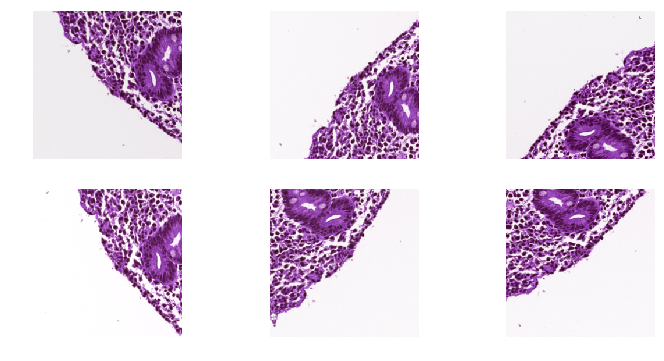

In [15]:
# Visualising the augmentation
def get_augs():
    data = ImageClassifierData.from_paths(PATH, bs=2, tfms=tfms, num_workers=1)
    x,_ = next(iter(data.aug_dl))
    return data.trn_ds.denorm(x)[1]
ims = np.stack([get_augs() for i in range(6)])
plots(ims, rows=2)

In [17]:
# Initializing the data with augmentation and learn method
data = ImageClassifierData.from_paths(PATH, tfms=tfms)
learn = ConvLearner.pretrained(arch, data, precompute=False)
learn.precompute = False

## Unfreezing layers and using Differential learning rates

In [18]:
# Unfreeze all layers for training
learn.unfreeze()

In [23]:
lrf=learn.lr_find()

 70%|███████   | 5139/7308 [46:52<19:08,  1.89it/s, loss=1.05]   

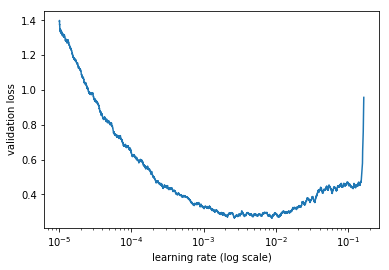

In [24]:
learn.sched.plot()

In [20]:
learn.load('1000x1000_256_resnet50_staintools')

In [21]:
learn.precompute = False
learn.predict()

array([[ -0.00001, -17.01775, -11.36519],
       [ -0.02037, -14.44292,  -3.90408],
       [ -0.00001, -15.72851, -11.60756],
       ...,
       [-11.15485, -16.95606,  -0.00001],
       [ -4.73926, -12.62919,  -0.00879],
       [ -3.42611, -16.6015 ,  -0.03305]], dtype=float32)

In [22]:
model = learn.model
model

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1

In [23]:
# Some Helper functions
from PIL import Image
def image_loader(path, expand_dim=False):
    img = Image.open(path)
#     img = img.resize((256, 256))
    img = np.array(img, dtype=np.float32)
    img = np.einsum('ijk->kij', img)
    if expand_dim:
        img = img[None]
    # convert to torch 
    img = torch.from_numpy(img)
    return img

In [24]:
def return_sequential(layer_num, model):
    return nn.Sequential(
            *list(model.children())[:layer_num]
        )

class get_activation_layer(nn.Module):
    def __init__(self, model, total_layers):
        super().__init__()
        self.model = model
        self.total_layers = total_layers
        self.layer_models = []
        for i in range(self.total_layers):
             self.layer_models.append(return_sequential(i, self.model))
    def forward(self, x):
        self.outputs = []
        for i in range(self.total_layers):
            self.outputs.append(self.layer_models[i](x))
        return self.outputs

In [25]:
tmp_model = get_activation_layer(model, 16)

In [39]:
!mkdir ../layers_vis

mkdir: cannot create directory ‘../layers_vis’: File exists


In [18]:
def visulaize_layers(outputs):
    for index, layer in enumerate(outputs):
        features = layer.data
        size_plot = features.shape[1]
        if size_plot % 2 != 0:
            size_plot += 1
        original_size = np.int(np.ceil(np.sqrt(size_plot)))
        f, axarr = plt.subplots(original_size + 1, original_size + 1, figsize=(40,40))
        i, j = 0,0
        counter = 1
        for blocks in features:
            for block in blocks:
                counter += 1
                x = block.cpu().numpy()
                if counter % original_size == 0:
                    i += 1
                    j = 0 

                axarr[i,j].imshow(x)
                j += 1
        counter = 0
        print(f'layer {index} done')
        f.savefig(f'../layers_vis/output{index}.jpg')
        print('image generated')
        if (index == 10):
            break

In [62]:
img_path = f'{PATH}valid/Celiac/C06-27_02_5994_4662_0.jpg'
i = image_loader(f'{PATH}valid/Celiac/C06-27_02_5994_4662_0.jpg', expand_dim=True)
i = i.cuda()

layer_outputs = tmp_model(Variable(i))

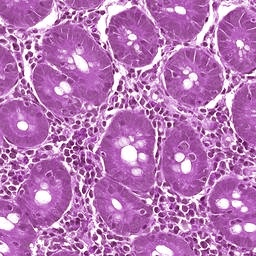

In [63]:
from IPython.display import Image as I
I(img_path)

In [ ]:
visulaize_layers(layer_outputs)

## Plotting Grad CAM

In [26]:
def get_cat_name(a):
    if a == 0:
        return 'Celiac'
    elif a == 1:
        return 'EE'
    elif a == 2:
        return 'Normal'
    else:
        return 'Something Wrong with label!'

In [27]:
class SaveFeatures():
    features=None
    def __init__(self, m): self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output): self.features = output
    def remove(self): self.hook.remove()

In [128]:
from IPython.display import Image as I
for i in range(0, 27):
    idx = i
    print(data.val_ds.fnames[idx])

valid/Celiac/C12-64_01a___6000_4000___0_250_0.jpg
valid/Celiac/C16-77_02___4000_0___0_0_0.jpg
valid/Celiac/C10-47_02___16000_18040___500_0_0.jpg
valid/Celiac/C16-77_01___4000_2000___500_0_0.jpg
valid/Celiac/C11-54_05___3000_2000___500_250_0.jpg
valid/Celiac/C04-24_00___12445_10931___250_500_0.jpg
valid/Celiac/C16-79_03___4000_4000___0_0_0.jpg
valid/Celiac/C12-64_01b___11000_0___250_0_0.jpg
valid/Celiac/C12-61_02___5000_2000___0_500_0.jpg
valid/Celiac/C10-47_01___15000_0___500_500_0.jpg
valid/Celiac/C14-70_04___5000_6000___0_0_0.jpg
valid/Celiac/C03-09_01___10000_3636___500_0_0.jpg
valid/Celiac/C06-32_02___4000_2000___0_0_0.jpg
valid/Celiac/C14-70_04___2000_2000___0_0_0.jpg
valid/Celiac/C12-64_01b___15000_5000___0_0_0.jpg
valid/Celiac/C10-47_02___11000_1000___0_250_0.jpg
valid/Celiac/C16-77_04___4000_1000___250_250_0.jpg
valid/Celiac/C03-09_01___8000_2000___500_0_0.jpg
valid/Celiac/C16-79_02___13000_9000___500_250_0.jpg
valid/Celiac/C16-77_01___2000_6000___500_250_0.jpg
valid/Celiac/C10

In [102]:
# Plot the image.
def display_image(img):
  plt.figure(); plt.imshow(img)
  plt.grid(False);  plt.axis('off'); plt.show()

In [119]:
i = iter(data.val_dl)
x, y = next(i)
x = x[None, 1]
vx = Variable(x.cuda(), requires_grad=True)
dx = data.val_ds.denorm(x)[0]

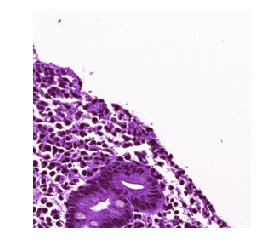

In [120]:
display_image(dx)

In [125]:
def plt_celiac_batch():
    it = iter(data.val_dl)
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    ximages , yimages = next(it)
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = ximages[None,i], yimages[None,i]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
#         sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
#         py = m(vx)
#         for o in sfs: o.remove()
#         feat = np.maximum(0,to_np(sfs[0].features[0]))
#         vx = Variable(x.cuda(), requires_grad=True)
#         py = np.exp(to_np(py)[0])
#         params = list(m.parameters())
#         weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
#         f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
#         f2-=f2.min()
#         f2/=f2.max()
        plt.imshow(dx)
#         plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

In [123]:
def plt_heatmap():
    it = iter(data.val_dl)
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    ximages , yimages = next(it)
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = ximages[None,i], yimages[None,i]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
        sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
        py = m(vx)
        for o in sfs: o.remove()
        feat = np.maximum(0,to_np(sfs[0].features[0]))
        vx = Variable(x.cuda(), requires_grad=True)
        py = np.exp(to_np(py)[0])
        params = list(m.parameters())
        weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
        f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
        f2-=f2.min()
        f2/=f2.max()
        plt.imshow(dx)
        plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


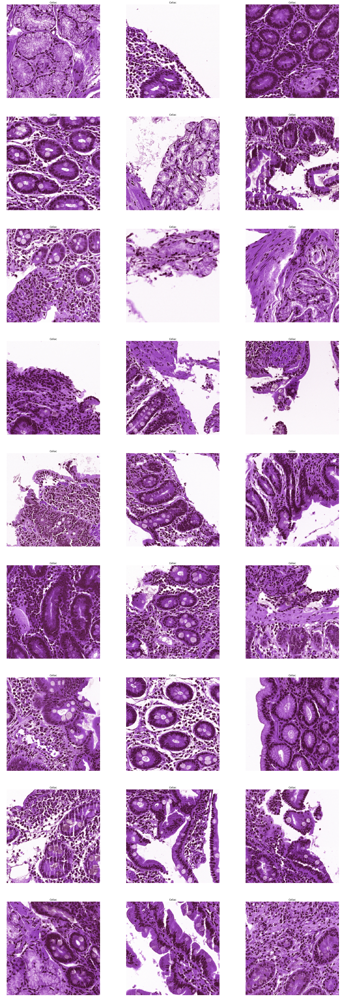

In [126]:
plt_celiac_batch()

/apps/software/standard/core/anaconda/5.2.0-py3.6/lib/python3.6/site-packages/ipykernel_launcher.py:25: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


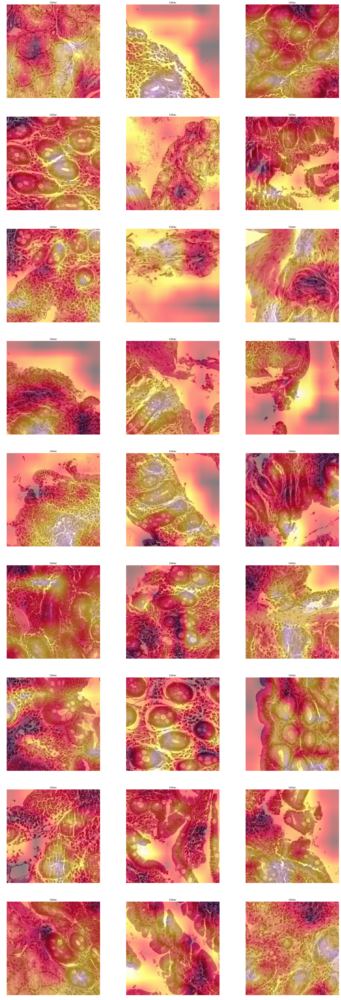

In [124]:
plt_heatmap()

In [134]:
counter = 0
for fname in data.val_ds.fnames:
    if 'ee' in fname.lower():
        print (counter)
        print (fname)
        break
    counter = counter + 1

16231
valid/EE/58___7360_3000___250_250_2.jpg


In [135]:
def plt_ee_batch():
    it = iter(data.val_dl)
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    ximages , yimages = next(it)
    for i in range(507):
        ximages , yimages = next(it)
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = ximages[None,i], yimages[None,i]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
#         sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
#         py = m(vx)
#         for o in sfs: o.remove()
#         feat = np.maximum(0,to_np(sfs[0].features[0]))
#         vx = Variable(x.cuda(), requires_grad=True)
#         py = np.exp(to_np(py)[0])
#         params = list(m.parameters())
#         weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
#         f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
#         f2-=f2.min()
#         f2/=f2.max()
        plt.imshow(dx)
#         plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

In [138]:
def plt_heatmap_EE():
    it = iter(data.val_dl)
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    ximages , yimages = next(it)
    for i in range(507):
        ximages , yimages = next(it)
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = ximages[None,i], yimages[None,i]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
        sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
        py = m(vx)
        for o in sfs: o.remove()
        feat = np.maximum(0,to_np(sfs[0].features[0]))
        vx = Variable(x.cuda(), requires_grad=True)
        py = np.exp(to_np(py)[0])
        params = list(m.parameters())
        weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
        f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
        f2-=f2.min()
        f2/=f2.max()
        plt.imshow(dx)
        plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

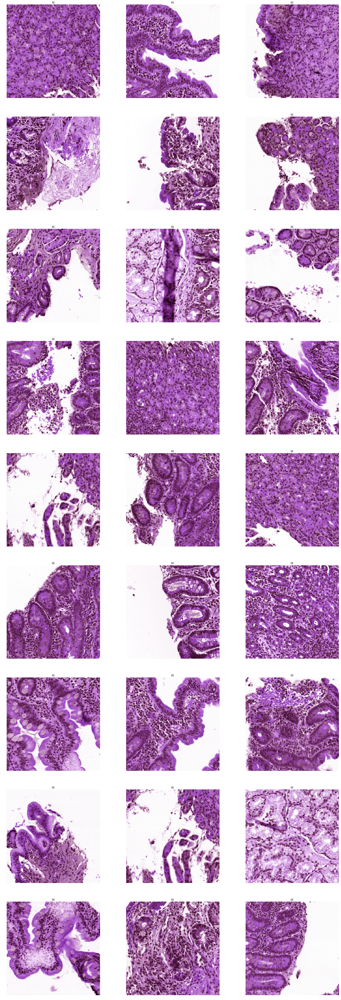

In [139]:
plt_ee_batch()

/apps/software/standard/core/anaconda/5.2.0-py3.6/lib/python3.6/site-packages/ipykernel_launcher.py:27: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for f

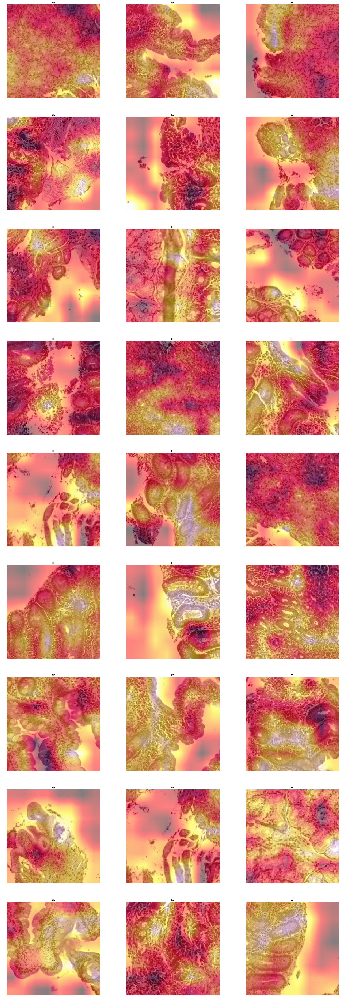

In [140]:
plt_heatmap_EE()

In [147]:
from IPython.display import Image as I
for i in range(0, 27):
    idx = i + 32*508
    print(data.val_ds.fnames[idx])

valid/EE/34___4000_4000___500_500_4.jpg
valid/EE/34___3000_4000___500_0_7.jpg
valid/EE/58___2000_1000___250_0_8.jpg
valid/EE/14_001___3000_4000___250_250_3.jpg
valid/EE/34___4000_4000___250_500_3.jpg
valid/EE/130378_6730_002___1000_3000___250_250_7.jpg
valid/EE/14_002___6000_3000___500_250_2.jpg
valid/EE/130378_6730_001___1496_4000___250_250_3.jpg
valid/EE/58___5000_3000___0_500_7.jpg
valid/EE/58___7360_3000___0_0_1.jpg
valid/EE/14_002___2000_1000___250_500_5.jpg
valid/EE/14_001___2000_3000___0_250_3.jpg
valid/EE/58___2000_0___500_500_2.jpg
valid/EE/14_001___4000_6138___500_250_1.jpg
valid/EE/14_002___6000_0___500_0_0.jpg
valid/EE/130364_6715_001___6241_0___500_500_4.jpg
valid/EE/11___2000_3000___0_500_1.jpg
valid/EE/81___5000_6000___0_250_8.jpg
valid/EE/130378_6730_002___2341_6000___250_500_3.jpg
valid/EE/81___2000_1000___250_0_1.jpg
valid/EE/11___2000_3000___250_250_2.jpg
valid/EE/130377_6729_001___5742_1000___250_250_1.jpg
valid/EE/130364_6715_001___4000_0___0_500_5.jpg
valid/EE/130

In [145]:
counter = 0
for fname in data.val_ds.fnames:
    if 'normal' in fname.lower():
        print (counter)
        print (fname)
        break
    counter = counter + 1
    
print(counter/32)

33223
valid/Normal/N17-58_03___2000_4000___500_0_1.jpg
1038.21875


In [151]:
def plt_normal_batch():
    it = iter(data.val_dl)
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    ximages , yimages = next(it)
    for i in range(1038):
        ximages , yimages = next(it)
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = ximages[None,i], yimages[None,i]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
#         sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
#         py = m(vx)
#         for o in sfs: o.remove()
#         feat = np.maximum(0,to_np(sfs[0].features[0]))
#         vx = Variable(x.cuda(), requires_grad=True)
#         py = np.exp(to_np(py)[0])
#         params = list(m.parameters())
#         weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
#         f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
#         f2-=f2.min()
#         f2/=f2.max()
        plt.imshow(dx)
#         plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');
    return ximages, yimages

In [152]:
def plt_heatmap_Normal(ximages, yimages):
#     it = iter(data.val_dl)
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
#     ximages , yimages = next(it)
#     for i in range(1038):
#         ximages , yimages = next(it)
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = ximages[None,i], yimages[None,i]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
        sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
        py = m(vx)
        for o in sfs: o.remove()
        feat = np.maximum(0,to_np(sfs[0].features[0]))
        vx = Variable(x.cuda(), requires_grad=True)
        py = np.exp(to_np(py)[0])
        params = list(m.parameters())
        weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
        f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
        f2-=f2.min()
        f2/=f2.max()
        plt.imshow(dx)
        plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

In [153]:
ximages, yimages = plt_normal_batch()

StopIteration: 

<Figure size 2160x6480 with 0 Axes>

In [ ]:
plt_heatmap_Normal(ximages, yimages)